# **GradCAM**
**Apply gradient-weighted Class Activation Maps to visualise how neural network perceive the classified object and what parts of picture really matters to its perception. GradCAM is used to check if tested network classifies with correct reasoning. It's a reverse way to search for incorrectness in dataset.**

*I find it fascinating to understand how AI can perceive visual inputs. Does the gestalt principles apply to deep learning similarly to human perception? What does it mean to percive an object?*

**tl;dr: Why GradCAM?**
- To have an understandable way to visualize sailency map on an image.
- To check if our animal is classified by its features and not by the floor pattern or weather in the background.

**Original paper:**

[Grad-CAM: Visual Explanations from Deep Networks via Gradient-based Localization](https://arxiv.org/pdf/1610.02391.pdf) by Selvaraju, Cogswell, Das, Vedantam, Parikh & Batra (2019)


In [1]:
import tensorflow as tf
import tensorflow_datasets as tfds

import cv2
import numpy as np
import matplotlib.pyplot as plt

## 1. Dataset
For the purpose of this task I'm using Cats vs Dogs dataset available via Tensorflow Datasets.*italicized text*

### 1.1 Load the dataset

In [2]:
DATASET_SPLIT = ['train[:80%]', 'train[80%:90%]', 'train[90%:]']

dataset, info = tfds.load('cats_vs_dogs', split=DATASET_SPLIT, as_supervised=True, with_info=True)

train_dataset, test_dataset, val_dataset = dataset

NUM_EXAMPLES = info.splits['train'].num_examples
NUM_CLASSES = info.features['label'].num_classes

print(f"Number of images: {NUM_EXAMPLES}")
print(f"Number of classes: {NUM_CLASSES} (It's just a basic classifier)")

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/cats_vs_dogs/4.0.0.incompleteRJX1VU/cats_vs_dogs-train.tfrecord*...:   0%|…

Dataset cats_vs_dogs downloaded and prepared to /root/tensorflow_datasets/cats_vs_dogs/4.0.0. Subsequent calls will reuse this data.
Number of images: 23262
Number of classes: 2 (It's just a basic classifier)


### 1.2 Preprocess the images in dataset
- Normalize the values
- Resize images
- Create batches of train, test and val datasets.

In [3]:
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 32

def preprocess(image, label):
    image = tf.image.resize(image, IMAGE_SIZE)
    image /= 255.0
    return image, label


train_batches = train_dataset.shuffle(NUM_EXAMPLES // 4)
train_batches = train_batches.map(preprocess)
train_batches = train_batches.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

test_batches = test_dataset.map(preprocess).batch(1)

val_batches = val_dataset.map(preprocess)
val_batches = val_batches.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

## 2. Model
**The model uses transfer learning from VGG16 and imagenet weights** with additional layers for binary classification.

### 2.1 Create model
Because we are using transfer learning we freeze all VGG16 layers except of last convolution block.

*I've been trying to define the model as a class but it has troubles in passing the shape between VGG16 and AvgPool layers which later produced some errors I couldn't debug.*

In [4]:
INPUT_SIZE = IMAGE_SIZE + (3,)

def create_model(shape=INPUT_SIZE, lr=0.001):
    base_model = tf.keras.applications.VGG16(input_shape=shape, weights='imagenet', include_top=False)
    x = tf.keras.layers.GlobalAveragePooling2D()(base_model.output)
    output = tf.keras.layers.Dense(2, activation='softmax')(x)

    model = tf.keras.models.Model(inputs=base_model.input, outputs=output)
    
    for layer in base_model.layers[:-4]:
        layer.trainable = False

    model.compile(
        optimizer=tf.keras.optimizers.RMSprop(learning_rate=lr),
        loss=tf.keras.losses.sparse_categorical_crossentropy,
        metrics=['accuracy']
    )
        
    return model

### 2.2 Compile

In [5]:
model = create_model()
model.summary()

58889256/58889256 [==============================] - 0s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                              

### 2.3 Train
3 Epochs are enough to reach accuracy above 95%

In [14]:
EPOCHS = 3
model.fit(train_batches, epochs=EPOCHS, validation_data=val_batches)

Epoch 1/3
582/582 [==============================] - 105s 169ms/step - loss: 0.1534 - accuracy: 0.9422 - val_loss: 0.2396 - val_accuracy: 0.9119
Epoch 2/3
582/582 [==============================] - 103s 169ms/step - loss: 0.1009 - accuracy: 0.9618 - val_loss: 0.0760 - val_accuracy: 0.9690
Epoch 3/3
582/582 [==============================] - 104s 168ms/step - loss: 0.0747 - accuracy: 0.9720 - val_loss: 0.0853 - val_accuracy: 0.9682


## 3. GradCAM
**Generate the class activation maps.**

### 3.1 Visualization model
Create a model which outputs all layers to visualize. We are using the layers from our VGG16 network.

In [15]:
outputs = [layer.output for layer in model.layers[1:18]]
layer_names = [layer.name.split("/")[0] for layer in outputs]

print("Layers to visualize:\n")
[print(name) for name in layer_names]
print(f"\nLayers amount: {len(layer_names)}")

visualization_model = tf.keras.models.Model(model.input, outputs)


Layers to visualize:

block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_pool
block5_conv1
block5_conv2
block5_conv3

Layers amount: 17


### 3.2. GradCAM model
**Calculate the gradients of class activations and create the heatmap data.**

In [16]:
def get_CAM(image, label, layer_name='block5_conv3'):

    model_grad = tf.keras.models.Model([model.inputs], [model.get_layer(layer_name).output, model.output])

    with tf.GradientTape() as tape:
        conv_output_values, predictions = model_grad(image)

        tape.watch(conv_output_values)

        pred_prob = predictions[:,1] 
        label = tf.cast(label, dtype=tf.float32)
        
        smoothing = 0.00001 
        

        loss = -1 * (label * tf.math.log(pred_prob + smoothing) + (1 - label) * tf.math.log(1 - pred_prob + smoothing))
        print(f"binary loss: {loss}")
    

    grads_values = tape.gradient(loss, conv_output_values)
    grads_values = tf.keras.backend.mean(grads_values, axis=(0,1,2))
    
    conv_output_values = np.squeeze(conv_output_values.numpy())
    grads_values = grads_values.numpy()
    

    for i in range(512): 
        conv_output_values[:,:,i] *= grads_values[i]
        
    heatmap = np.mean(conv_output_values, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= heatmap.max()
    
    del model_grad, conv_output_values, grads_values, loss
   
    return heatmap

**Generate the heatmap and convert it to image:**

In [17]:
def generate_heatmap(sample_image_processed, sample_label):

    heatmap = get_CAM(sample_image_processed, sample_label)

    heatmap = cv2.resize(heatmap, IMAGE_SIZE)
    heatmap = heatmap * 255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_HOT)
    return heatmap

**Helper functions to show the results as images:**

In [64]:
def get_sample_activation(activations):
    sample_activation = activations[0][0,:,:,16]
    sample_activation -= sample_activation.mean()
    sample_activation /= sample_activation.std()
    sample_activation *= 255
    sample_activation = np.clip(sample_activation, 0, 255)

    return sample_activation.astype(np.uint8)


def get_sample_image():
    sample = test_batches.shuffle(1000).take(1)
    sample = iter(sample)
    image, label = next(sample)

    return image[0], label[0]


def plot_results(sample_image, sample_activation, heatmap):

    figure, rows = plt.subplots(2,2, figsize=(8,8))

    rows[0,0].imshow(sample_image)
    rows[0,0].set_title("Image")
    rows[0,0].axis('off')
    
    rows[0,1].imshow(sample_activation)
    rows[0,1].set_title("Random feature map")
    rows[0,1].axis('off')
    
    rows[1,0].imshow(heatmap)
    rows[1,0].set_title("Class Activation Map")
    rows[1,0].axis('off')
    
    converted_img = sample_image.numpy()
    super_imposed_image = cv2.addWeighted(converted_img, 0.8, heatmap.astype('float32'), 2e-3, 0.0)

    rows[1,1].imshow(super_imposed_image)
    rows[1,1].set_title("Activation map superimposed")
    rows[1,1].axis('off')
    plt.tight_layout()
    plt.show()

### 3.3 Generate the heatmap and visualize the results

1/1 [==============================] - 0s 19ms/step
binary loss: [0.39406237]

True label: Cat, Predicted label: Cat



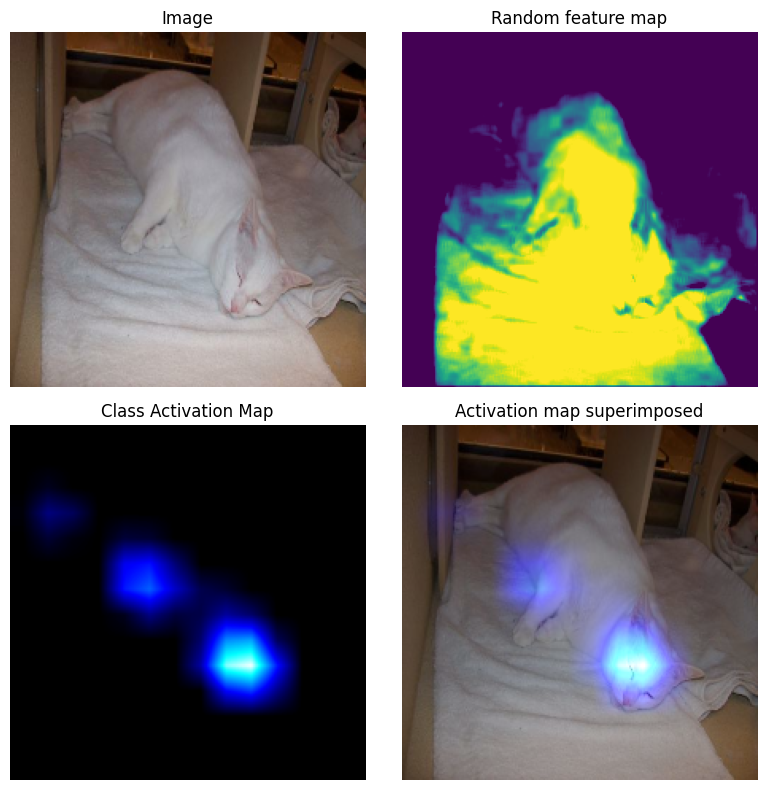

In [75]:
sample_image, sample_label = get_sample_image()
sample_image_processed = np.expand_dims(sample_image, axis=0)

activations = visualization_model.predict(sample_image_processed)

pred_label = model.predict(sample_image_processed)
# pred_label = np.argmax(pred_label, axis=-1)[0]

heatmap = generate_heatmap(sample_image_processed, sample_label)

sample_activation = get_sample_activation(activations)

print(f"\nTrue label: {'Dog' if sample_label else 'Cat'}, Predicted label: {'Dog' if np.argmax(pred_label, axis=-1)[0] else 'Cat'}\n")

plot_results(sample_image, sample_activation, heatmap)

## 4. Visualize the intermediate activation of convolutions.

In [76]:
def visualize_intermediate_activations(layer_names, activations):

    for layer_name, layer_activation in zip(layer_names, activations):
        nb_features = layer_activation.shape[-1]
        size= layer_activation.shape[1]

        IMAGES_PER_ROW = 16
        NUMBER_OF_COLS = nb_features // IMAGES_PER_ROW


        grid = np.zeros((size * NUMBER_OF_COLS, size * IMAGES_PER_ROW))

        for col in range(NUMBER_OF_COLS):
            for row in range(IMAGES_PER_ROW):
                feature_map_index = col * IMAGES_PER_ROW + row
                feature_map = layer_activation[0,:,:,feature_map_index]
                feature_map -= feature_map.mean()
                feature_map /= feature_map.std()
                feature_map *= 255
                feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)

                grid[col * size:(col+1) * size, row * size:(row+1) * size] = feature_map

        scale = 1./size
        plt.figure(figsize=(scale * grid.shape[1], scale * grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.axis('off')
        plt.imshow(grid, aspect='auto', cmap='viridis')

    plt.show()

<ipython-input-76-097829789043>:18: RuntimeWarning: invalid value encountered in true_divide
  feature_map /= feature_map.std()


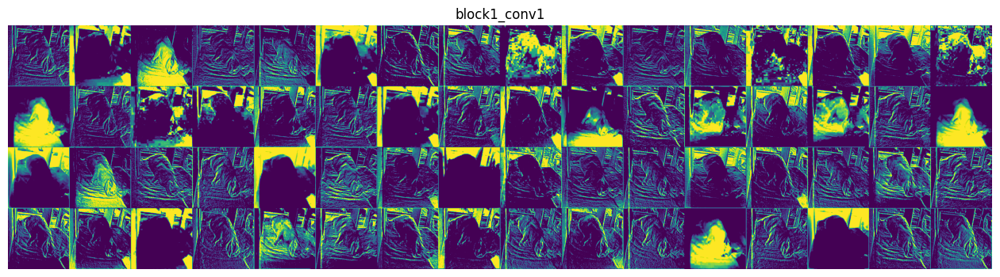

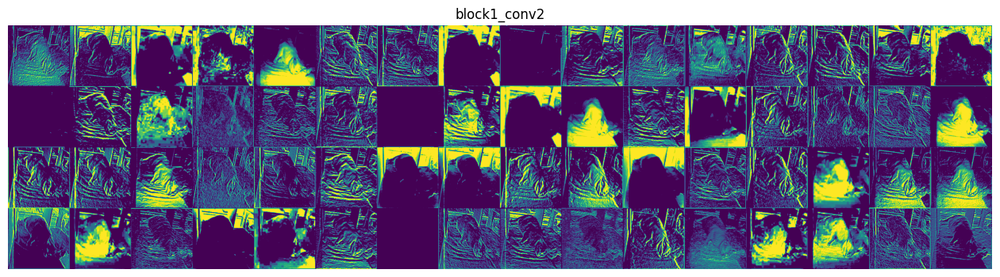

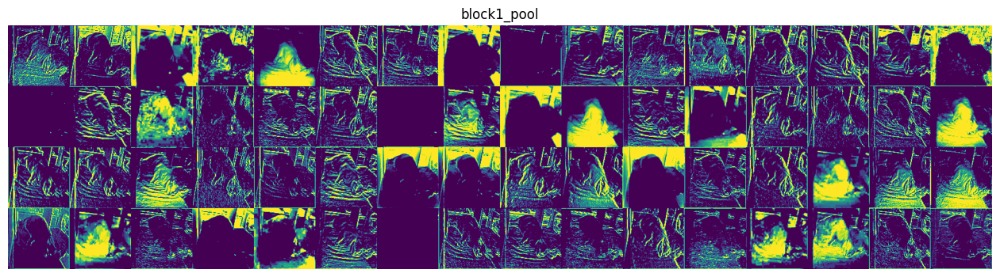

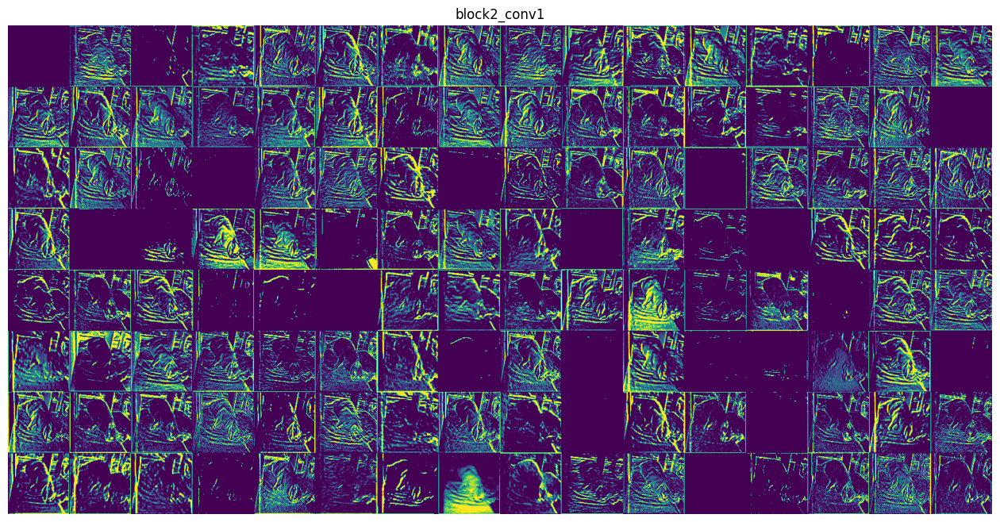

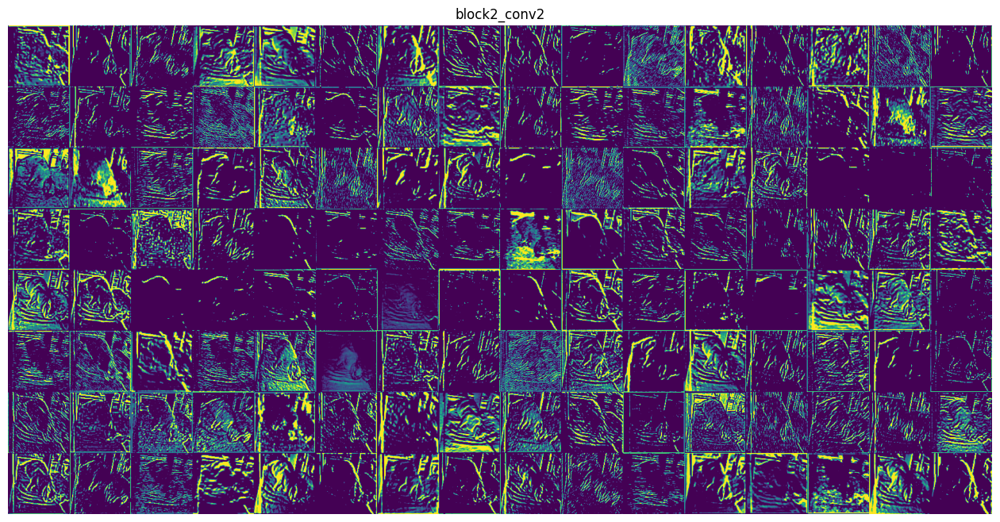

...

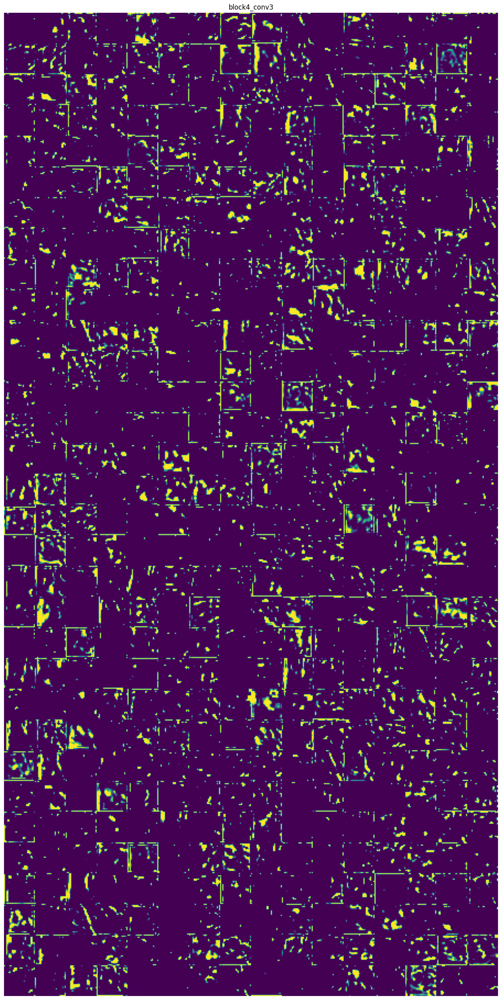

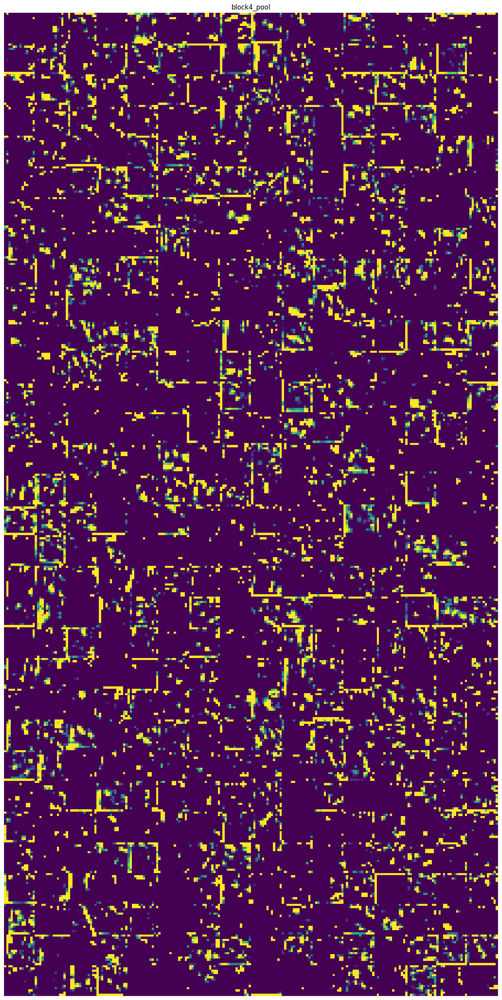

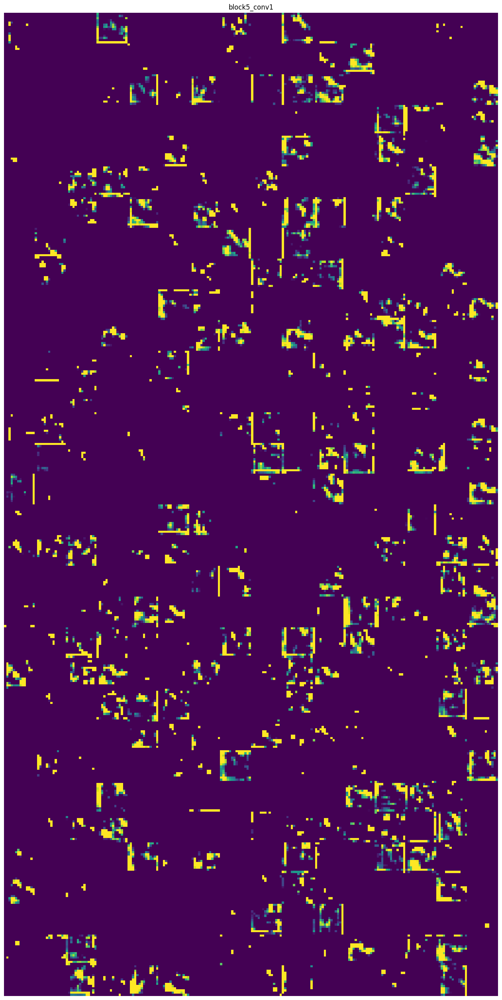

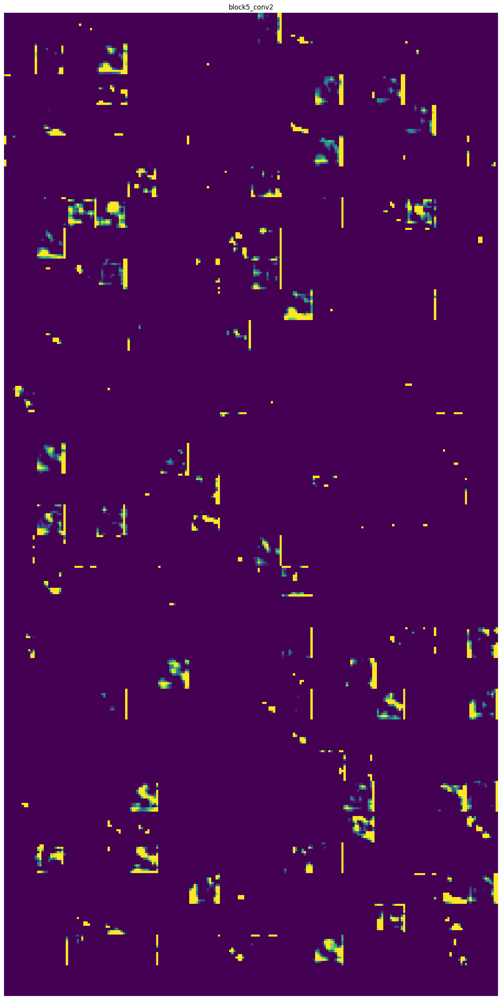

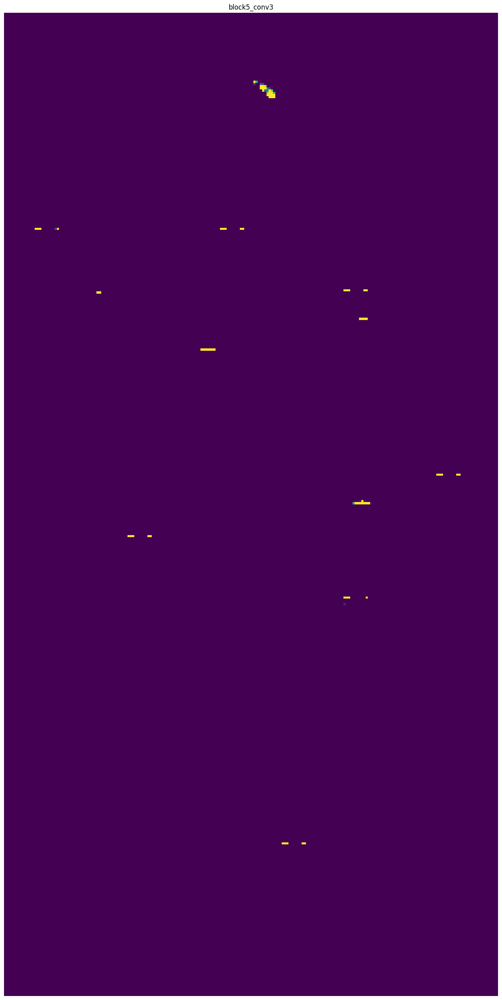

In [77]:
visualize_intermediate_activations(activations=activations, layer_names=layer_names)